# Brain Tumor Object Detection<br>
Implementing a brain tumor detection system using YOLOv8. Curate a diverse dataset, annotate images, and train models for accurate detection. Emphasizing ethical healthcare data usage, this project seeks robust precision and recall in identifying brain tumors through the YOLOv8 along with different sizes and optimizers.

## **Data Collection**

[Dataset](https://www.kaggle.com/datasets/ammarahmed310/labeled-mri-brain-tumor-dataset)<br>
A comprehensive dataset consisting of brain scans from multiple imaging modalities, including MRI, has been chosen for the training of the YOLOv7 model. The dataset has been carefully selected to provide exposure to a wide variety of clinical situations, including cases of pituitary, meningioma, glioma, and no tumor. The dataset was obtained from Kagle and Hayatabad Medical Complex Peshawar. The specifications of the dataset, consisting of 1594 healthy brain samples, 1321 glioma, 1339 meningioma, and 1457 pituitary brain tumor samples.

## Importing Libraries

In [ ]:
!pip install Augmentor
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 722.9/722.9 kB 4.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 41.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 66.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 44.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 1.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 9.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 10.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.0/196.0 MB 6.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 166.0/166.0 MB 7.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.1/99.1 kB 15.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.patches as patches
import cv2
import math
import os
import zipfile
import random
import shutil
import Augmentor
from sklearn.model_selection import train_test_split
from ultralytics import YOLO
from PIL import Image
from IPython.display import display

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## EDA

In [ ]:
zip_path = '/content/drive/MyDrive/brain_tumor_object_detection/data/data.zip'
extract_path = '/content/drive/MyDrive/brain_tumor_object_detection/data'

with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

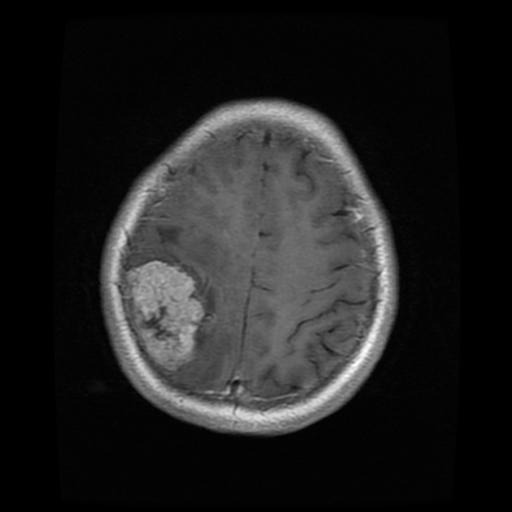

In [ ]:
sample_image = Image.open('/content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/meningioma/Tr-me_0011.jpg')
sample_image

In [ ]:
sample_image.size

(512, 512)

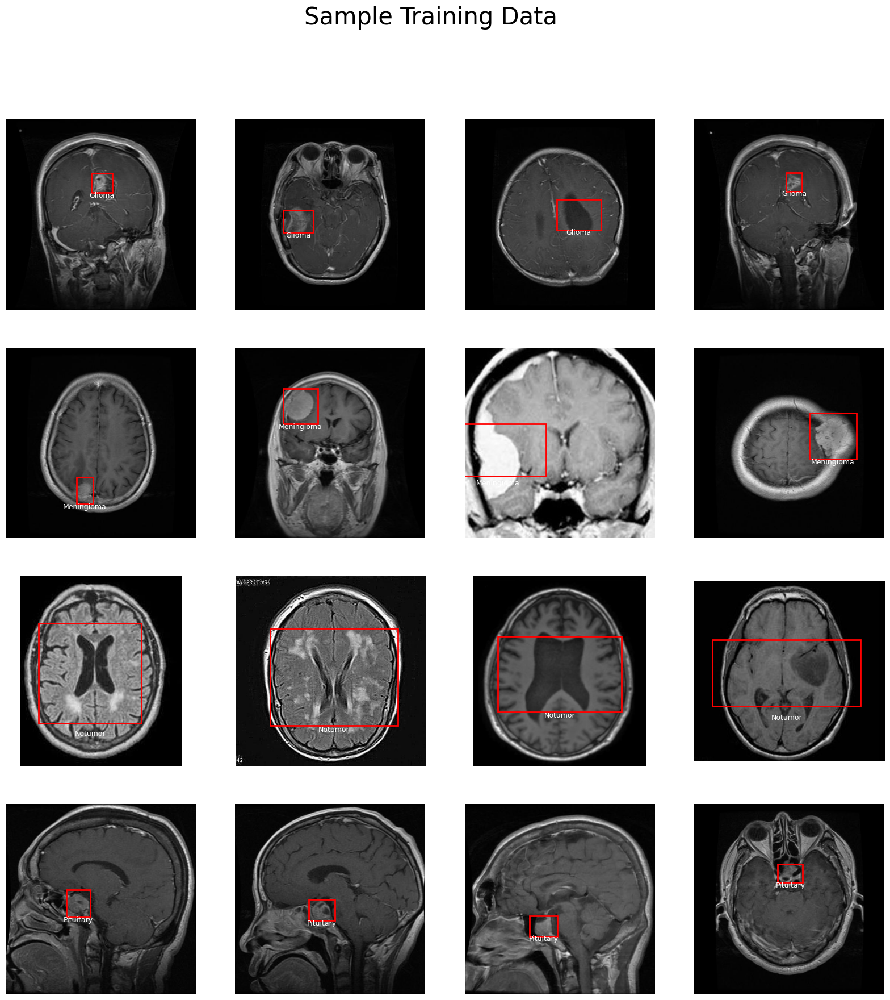

In [ ]:
# Plotting the training data with bounding boxes
dataset_directory = '/content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/'
class_labels = {'glioma': 0, 'meningioma': 1, 'notumor': 2, 'pituitary': 3}

fig, axes = plt.subplots(4, 4, figsize=(20, 20))

for class_name, ax_row in zip(class_labels.keys(), axes):
    class_directory = os.path.join(dataset_directory, class_name)
    image_files = [f for f in os.listdir(class_directory) if f.endswith('.jpg')]
    selected_images = random.sample(image_files, 4)

    for ax, image_file in zip(ax_row, selected_images):
        annotation_file = os.path.join(class_directory, image_file.replace('.jpg', '.txt'))
        with open(annotation_file, 'r') as file:
            line = file.readline().strip().split()
            class_number, centre_x, centre_y, height, width = map(float, line)

        img = plt.imread(os.path.join(class_directory, image_file))

        if len(img.shape) == 2:
            img = np.stack((img,) * 3, axis=-1)

        img_height, img_width, _ = img.shape
        x_min = (centre_x - width / 2) * img_width
        y_min = (centre_y - height / 2) * img_height
        x_max = (centre_x + width / 2) * img_width
        y_max = (centre_y + height / 2) * img_height
        tumor_bbox = patches.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min, linewidth=2, edgecolor='r', facecolor='none', label=f'{class_name.capitalize()}')
        ax.imshow(img)
        ax.add_patch(tumor_bbox)

        label_text = f'{class_name.capitalize()}'
        ax.text((x_min + x_max) / 2, y_max + 18, label_text, color='w', ha='center', va='bottom', fontsize=9)

for ax_row in axes:
    for ax in ax_row:
        ax.axis('off')

plt.suptitle("Sample Training Data", fontsize=30)
plt.show()

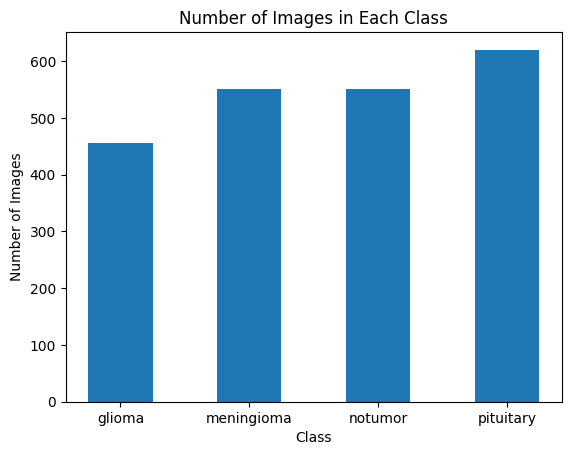

In [ ]:
class_names = ['glioma', 'meningioma', 'notumor', 'pituitary']
class_counts = [456, 551, 550, 620]

plt.bar(class_names, class_counts, width=0.5)
plt.xlabel('Class')
plt.ylabel('Number of Images')
plt.title('Number of Images in Each Class')
plt.show()

## Train-Test Split

In [ ]:
def custom_train_test_split(dataset_directory, test_ratio=0.2, random_seed=None, min_samples_per_class=2):
    """
    Custom function to perform a stratified train-test split on an image dataset.
    This function organizes the dataset into 'train' and 'test' directories while maintaining the class-wise distribution.
    It creates the 'train' and 'test' directories within the given dataset directory and moves images accordingly.
    """
    random_seed = random_seed or 42

    class_directories = [d for d in os.listdir(dataset_directory) if os.path.isdir(os.path.join(dataset_directory, d))]

    train_directory = os.path.join(dataset_directory, 'train')
    test_directory = os.path.join(dataset_directory, 'test')
    os.makedirs(train_directory, exist_ok=True)
    os.makedirs(test_directory, exist_ok=True)

    for class_dir in class_directories:
        class_path = os.path.join(dataset_directory, class_dir)

        image_files = [f for f in os.listdir(class_path) if f.endswith('.jpg')]

        if len(image_files) < min_samples_per_class:
            continue

        train_images, test_images = train_test_split(image_files, test_size=test_ratio, random_state=random_seed)

        for train_image in train_images:
            src_image_path = os.path.join(class_path, train_image)
            src_annotation_path = os.path.join(class_path, train_image.replace('.jpg', '.txt'))

            dest_image_path = os.path.join(train_directory, class_dir, train_image)
            dest_annotation_path = os.path.join(train_directory, class_dir, train_image.replace('.jpg', '.txt'))

            os.makedirs(os.path.dirname(dest_image_path), exist_ok=True)

            if os.path.exists(src_annotation_path):
                shutil.move(src_image_path, dest_image_path)
                shutil.move(src_annotation_path, dest_annotation_path)

        for test_image in test_images:
            src_image_path = os.path.join(class_path, test_image)
            src_annotation_path = os.path.join(class_path, test_image.replace('.jpg', '.txt'))

            dest_image_path = os.path.join(test_directory, class_dir, test_image)
            dest_annotation_path = os.path.join(test_directory, class_dir, test_image.replace('.jpg', '.txt'))

            os.makedirs(os.path.dirname(dest_image_path), exist_ok=True)

            if os.path.exists(src_annotation_path):
                shutil.move(src_image_path, dest_image_path)
                shutil.move(src_annotation_path, dest_annotation_path)

In [ ]:
dataset_directory = '/content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/'
custom_train_test_split(dataset_directory, test_ratio=0.2, random_seed=42, min_samples_per_class=2)

In [ ]:
def count_images_per_class(directory):
    class_counts = {}
    for class_dir in os.listdir(directory):
        class_path = os.path.join(directory, class_dir)
        if os.path.isdir(class_path):
            class_counts[class_dir] = len([f for f in os.listdir(class_path) if f.endswith('.jpg')])
    return class_counts

In [ ]:
def plot_image_counts(train_directory, test_directory):
    """
    Plot the number of images in each class for both the training and testing sets.
    This function counts the number of images in each class for both the training and testing sets
    and plots a bar chart to visualize the distribution.
    """
    train_counts = count_images_per_class(train_directory)
    test_counts = count_images_per_class(test_directory)

    class_names = list(train_counts.keys())
    train_counts_values = list(train_counts.values())
    test_counts_values = [test_counts[class_name] for class_name in class_names]

    bar_width = 0.35
    index = range(len(class_names))

    fig, ax = plt.subplots()
    bar1 = ax.bar(index, train_counts_values, bar_width, label='Train')
    bar2 = ax.bar([i + bar_width for i in index], test_counts_values, bar_width, label='Test')

    ax.set_xlabel('Class')
    ax.set_ylabel('Number of Images')
    ax.set_title('Number of Images in Each Class for Train and Test Sets')
    ax.set_xticks([i + bar_width/2 for i in index])
    ax.set_xticklabels(class_names)
    ax.legend()

    plt.show()

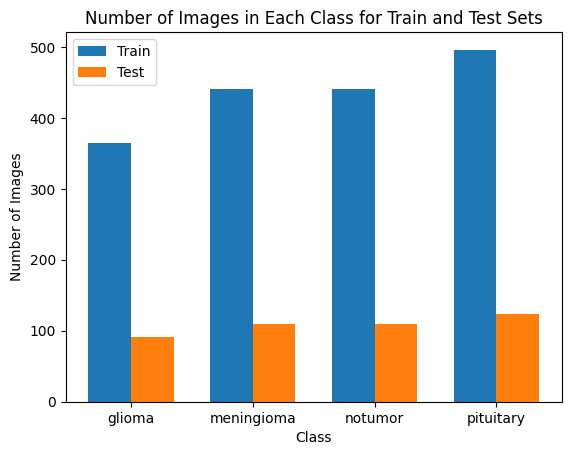

In [ ]:
dataset_directory = '/content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/'
train_directory = os.path.join(dataset_directory, 'train')
test_directory = os.path.join(dataset_directory, 'test')

plot_image_counts(train_directory, test_directory)

## YOLOv8n

### Modelling

In [ ]:
yolo_btd_model = YOLO('yolov8n.yaml')

yolo_btd_model_results = yolo_btd_model.train(data='/content/drive/MyDrive/brain_tumor_object_detection/brain_tumor_dataset.yaml', epochs=25)


                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128

100%|██████████| 755k/755k [00:00<00:00, 26.3MB/s]


Overriding model.yaml nc=80 with nc=4

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

100%|██████████| 6.23M/6.23M [00:00<00:00, 124MB/s]


WARNING ⚠️ NMS time limit 0.550s exceeded
AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/train/glioma... 1740 images, 2 backgrounds, 0 corrupt: 100%|██████████| 1740/1740 [15:44<00:00,  1.84it/s]


train: New cache created: /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/train/glioma.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/glioma... 435 images, 0 backgrounds, 0 corrupt: 100%|██████████| 435/435 [03:50<00:00,  1.89it/s]


val: New cache created: /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/glioma.cache
Plotting labels to runs/detect/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.00125, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
25 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/25      2.39G      3.356      4.952      4.074         21        640: 100%|██████████| 109/109 [00:46<00:00,  2.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:07<00:00,  1.85it/s]

                   all        435        439      0.769     0.0341     0.0121    0.00487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/25      2.27G      2.901      4.124      3.294         20        640: 100%|██████████| 109/109 [00:42<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:05<00:00,  2.60it/s]

                   all        435        439      0.443      0.168      0.133     0.0496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/25      2.27G      2.586      3.307      2.872         21        640: 100%|██████████| 109/109 [00:42<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:04<00:00,  2.85it/s]


                   all        435        439      0.516      0.272      0.244     0.0903

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/25      2.26G      2.291      2.688      2.576         19        640: 100%|██████████| 109/109 [00:42<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:05<00:00,  2.68it/s]

                   all        435        439      0.574      0.509      0.476      0.208



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/25      2.27G      2.089       2.31      2.366         21        640: 100%|██████████| 109/109 [00:42<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:05<00:00,  2.71it/s]

                   all        435        439      0.659      0.489      0.564       0.28



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/25      2.27G      1.999      2.056      2.264         18        640: 100%|██████████| 109/109 [00:42<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:05<00:00,  2.66it/s]

                   all        435        439      0.638      0.546      0.581      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/25      2.26G      1.926      1.877      2.183         21        640: 100%|██████████| 109/109 [00:41<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:05<00:00,  2.72it/s]

                   all        435        439      0.611      0.519      0.601      0.294



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/25      2.26G      1.833        1.8      2.104         17        640: 100%|██████████| 109/109 [00:42<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:05<00:00,  2.49it/s]

                   all        435        439      0.726      0.638        0.7      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/25      2.27G      1.804      1.689      2.066         18        640: 100%|██████████| 109/109 [00:41<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:06<00:00,  2.24it/s]

                   all        435        439      0.779      0.628      0.746      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/25      2.26G      1.744      1.578      1.987         24        640: 100%|██████████| 109/109 [00:42<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:07<00:00,  1.86it/s]

                   all        435        439      0.774      0.667      0.754      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/25      2.26G      1.704      1.563       1.95         19        640: 100%|██████████| 109/109 [00:43<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:05<00:00,  2.40it/s]

                   all        435        439      0.706      0.686      0.754      0.399



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/25      2.26G       1.68      1.492      1.928         24        640: 100%|██████████| 109/109 [00:43<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:05<00:00,  2.66it/s]

                   all        435        439      0.717      0.666      0.737      0.398



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/25      2.27G      1.636      1.433      1.884         22        640: 100%|██████████| 109/109 [00:43<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:05<00:00,  2.70it/s]


                   all        435        439      0.818      0.641      0.765      0.412

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/25      2.26G       1.67      1.438      1.901         18        640: 100%|██████████| 109/109 [00:42<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:05<00:00,  2.80it/s]

                   all        435        439      0.774      0.706      0.796      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/25      2.26G       1.63      1.427      1.876         21        640: 100%|██████████| 109/109 [00:43<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:05<00:00,  2.40it/s]

                   all        435        439      0.765      0.716      0.794      0.427


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/25      2.27G      1.577      1.348      2.001         12        640: 100%|██████████| 109/109 [00:43<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:06<00:00,  2.11it/s]

                   all        435        439      0.828      0.724      0.804      0.457



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/25      2.27G      1.548      1.253      1.985         12        640: 100%|██████████| 109/109 [00:38<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:06<00:00,  2.31it/s]

                   all        435        439        0.8      0.765      0.815      0.462



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/25      2.27G      1.504      1.177      1.939         12        640: 100%|██████████| 109/109 [00:39<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:05<00:00,  2.64it/s]


                   all        435        439      0.818      0.742      0.836      0.477

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/25      2.27G      1.482      1.125      1.918         14        640: 100%|██████████| 109/109 [00:40<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:05<00:00,  2.71it/s]

                   all        435        439      0.787      0.767      0.833      0.468



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/25      2.27G      1.467      1.097      1.907         12        640: 100%|██████████| 109/109 [00:40<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:05<00:00,  2.64it/s]

                   all        435        439      0.855      0.769      0.845      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/25      2.27G      1.451      1.034      1.887         13        640: 100%|██████████| 109/109 [00:40<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:04<00:00,  2.86it/s]

                   all        435        439       0.82      0.801      0.874      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/25      2.27G      1.425      1.022      1.868         13        640: 100%|██████████| 109/109 [00:40<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:05<00:00,  2.61it/s]

                   all        435        439      0.841      0.802      0.867        0.5



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/25      2.27G        1.4     0.9897      1.834         12        640: 100%|██████████| 109/109 [00:40<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:04<00:00,  2.88it/s]

                   all        435        439      0.856       0.82      0.881       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/25      2.27G       1.39     0.9778      1.844         14        640: 100%|██████████| 109/109 [00:40<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:05<00:00,  2.46it/s]

                   all        435        439      0.908      0.792      0.888      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/25      2.27G      1.383     0.9447      1.822         12        640: 100%|██████████| 109/109 [00:40<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:06<00:00,  2.31it/s]

                   all        435        439      0.899      0.791      0.891      0.526



25 epochs completed in 0.341 hours.
Optimizer stripped from runs/detect/train3/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train3/weights/best.pt, 6.2MB

Validating runs/detect/train3/weights/best.pt...
Ultralytics YOLOv8.1.2 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8n summary (fused): 168 layers, 3006428 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:08<00:00,  1.71it/s]


                   all        435        439      0.901      0.791      0.891      0.526
                glioma        435        125      0.927      0.864      0.952      0.478
            meningioma        435        110       0.94      0.882      0.951      0.574
               notumor        435         94      0.797        0.5      0.685      0.331
             pituitary        435        110      0.939      0.918      0.978      0.722
Speed: 0.3ms preprocess, 2.6ms inference, 0.0ms loss, 4.3ms postprocess per image
Results saved to runs/detect/train3


### Performance Metrics

In [ ]:
def plot_images(image_paths):
    fig, axes = plt.subplots(len(image_paths), 1, figsize=(80, 80))

    for i, ax in enumerate(axes):
        image_path = image_paths[i]
        img = mpimg.imread(image_path)
        ax.imshow(img)
        ax.axis('off')
        ax.set_title(os.path.basename(image_path))

    plt.tight_layout()
    plt.show()

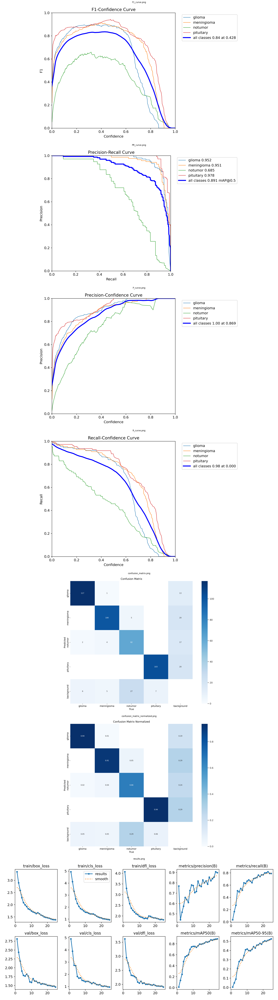

In [ ]:
image_paths = [
    '/content/drive/MyDrive/brain_tumor_object_detection/runs/detect/train3/F1_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/runs/detect/train3/PR_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/runs/detect/train3/P_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/runs/detect/train3/R_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/runs/detect/train3/confusion_matrix.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/runs/detect/train3/confusion_matrix_normalized.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/runs/detect/train3/results.png',
]
plot_images(image_paths)

### Testing

In [ ]:
def predict_results(test_images_dir):
    model = YOLO('/content/drive/MyDrive/brain_tumor_object_detection/runs/detect/train3/weights/best.pt')
    os.makedirs(output_dir, exist_ok=True)

    image_files = [f for f in os.listdir(test_images_dir) if f.lower().endswith('.jpg')]

    for image_file in image_files:
        image_path = os.path.join(test_images_dir, image_file)
        model.predict(image_path, save=True, imgsz=320, conf=0.3)

In [ ]:
glioma_test_dir = '/content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/glioma'
predict_results(glioma_test_dir)


image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/glioma/Tr-gl_0011.jpg: 320x320 1 notumor, 110.4ms
Speed: 1.9ms preprocess, 110.4ms inference, 1.1ms postprocess per image at shape (1, 3, 320, 320)
Results saved to runs/detect/predict2

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/glioma/Tr-gl_0022.jpg: 320x320 1 notumor, 66.3ms
Speed: 1.8ms preprocess, 66.3ms inference, 0.8ms postprocess per image at shape (1, 3, 320, 320)
Results saved to runs/detect/predict2

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/glioma/Tr-gl_0025.jpg: 320x320 1 notumor, 66.6ms
Speed: 1.6ms preprocess, 66.6ms inference, 0.8ms postprocess per image at shape (1, 3, 320, 320)
Results saved to runs/detect/predict2

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/glioma/Tr-gl_0029.jpg: 320x320 2 notumors,

In [ ]:
meningioma_test_dir = '/content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/meningioma'
predict_results(meningioma_test_dir)


image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/meningioma/Tr-me_0165.jpg: 320x320 1 meningioma, 105.9ms
Speed: 1.9ms preprocess, 105.9ms inference, 1.5ms postprocess per image at shape (1, 3, 320, 320)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/meningioma/Tr-me_0173.jpg: 320x320 (no detections), 149.0ms
Speed: 1.8ms preprocess, 149.0ms inference, 5.9ms postprocess per image at shape (1, 3, 320, 320)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/meningioma/Tr-me_0219.jpg: 320x320 1 meningioma, 217.5ms
Speed: 1.7ms preprocess, 217.5ms inference, 1.4ms postprocess per image at shape (1, 3, 320, 320)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/meningioma/Tr-me_

In [ ]:
notumor_test_dir = '/content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/notumor'
predict_results(notumor_test_dir)


image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/notumor/Tr-no_0142.jpg: 320x320 1 pituitary, 105.2ms
Speed: 1.7ms preprocess, 105.2ms inference, 1.3ms postprocess per image at shape (1, 3, 320, 320)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/notumor/Tr-no_0165.jpg: 320x320 1 pituitary, 238.3ms
Speed: 1.6ms preprocess, 238.3ms inference, 1.1ms postprocess per image at shape (1, 3, 320, 320)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/notumor/Tr-no_0294.jpg: 224x320 1 pituitary, 98.6ms
Speed: 1.4ms preprocess, 98.6ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 320)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/notumor/Tr-no_0019.jpg: 320x320 2 

In [ ]:
pituitary_test_dir = '/content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/pituitary'
predict_results(pituitary_test_dir)


image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/pituitary/Tr-pi_0509.jpg: 320x320 1 glioma, 72.7ms
Speed: 1.6ms preprocess, 72.7ms inference, 0.9ms postprocess per image at shape (1, 3, 320, 320)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/pituitary/Tr-pi_0096.jpg: 320x320 1 glioma, 146.8ms
Speed: 5.3ms preprocess, 146.8ms inference, 1.4ms postprocess per image at shape (1, 3, 320, 320)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/pituitary/Tr-pi_0012.jpg: 320x320 1 glioma, 88.9ms
Speed: 1.4ms preprocess, 88.9ms inference, 1.0ms postprocess per image at shape (1, 3, 320, 320)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/pituitary/Tr-pi_0016.jpg: 320x320 1 not

In [ ]:
# Testing on video
VIDEOS_DIR = os.path.join('.', 'videos')

video_path = '/content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/test_video.mp4'
video_path_out = '{}_out.mp4'.format(video_path)

cap = cv2.VideoCapture(video_path)
ret, frame = cap.read()
H, W, _ = frame.shape
out = cv2.VideoWriter(video_path_out, cv2.VideoWriter_fourcc(*'MP4V'), int(cap.get(cv2.CAP_PROP_FPS)), (W, H))

threshold = 0.5

while ret:

    results = yolo_btd_model(frame)[0]

    for result in results.boxes.data.tolist():
        x1, y1, x2, y2, score, class_id = result

        if score > threshold:
            cv2.rectangle(frame, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 4)
            cv2.putText(frame, results.names[int(class_id)].upper(), (int(x1), int(y1 - 10)),
                        cv2.FONT_HERSHEY_SIMPLEX, 1.3, (0, 255, 0), 3, cv2.LINE_AA)

    out.write(frame)
    ret, frame = cap.read()

cap.release()
out.release()
cv2.destroyAllWindows()

Streaming output truncated to the last 5000 lines.
0: 640x512 1 pituitary, 12.8ms
Speed: 2.3ms preprocess, 12.8ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 512)

0: 640x512 1 pituitary, 11.0ms
Speed: 2.3ms preprocess, 11.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 512)

0: 640x512 1 pituitary, 10.5ms
Speed: 2.3ms preprocess, 10.5ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 512)

0: 640x512 1 pituitary, 11.9ms
Speed: 2.3ms preprocess, 11.9ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 512)

0: 640x512 1 pituitary, 11.5ms
Speed: 2.3ms preprocess, 11.5ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 512)

0: 640x512 1 pituitary, 15.0ms
Speed: 2.4ms preprocess, 15.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 512)

0: 640x512 1 pituitary, 15.0ms
Speed: 2.6ms preprocess, 15.0ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 512)

0: 640x512 1 pituitary, 15.0ms
Speed: 3.9ms pr

In [ ]:
def get_random_images_from_dir(directory, num_images=5):
    all_images = [f for f in os.listdir(directory) if f.lower().endswith('.jpg')]
    random_images = random.sample(all_images, min(num_images, len(all_images)))
    return [os.path.join(directory, img) for img in random_images]

In [ ]:
def display_images(images, num_images_per_row=5):
    fig, axs = plt.subplots(len(images) // num_images_per_row, num_images_per_row, figsize=(30, 30))
    axs = axs.flatten()

    for i, img_path in enumerate(images):
        img = mpimg.imread(img_path)
        axs[i].imshow(img)
        axs[i].axis('off')

    plt.show()

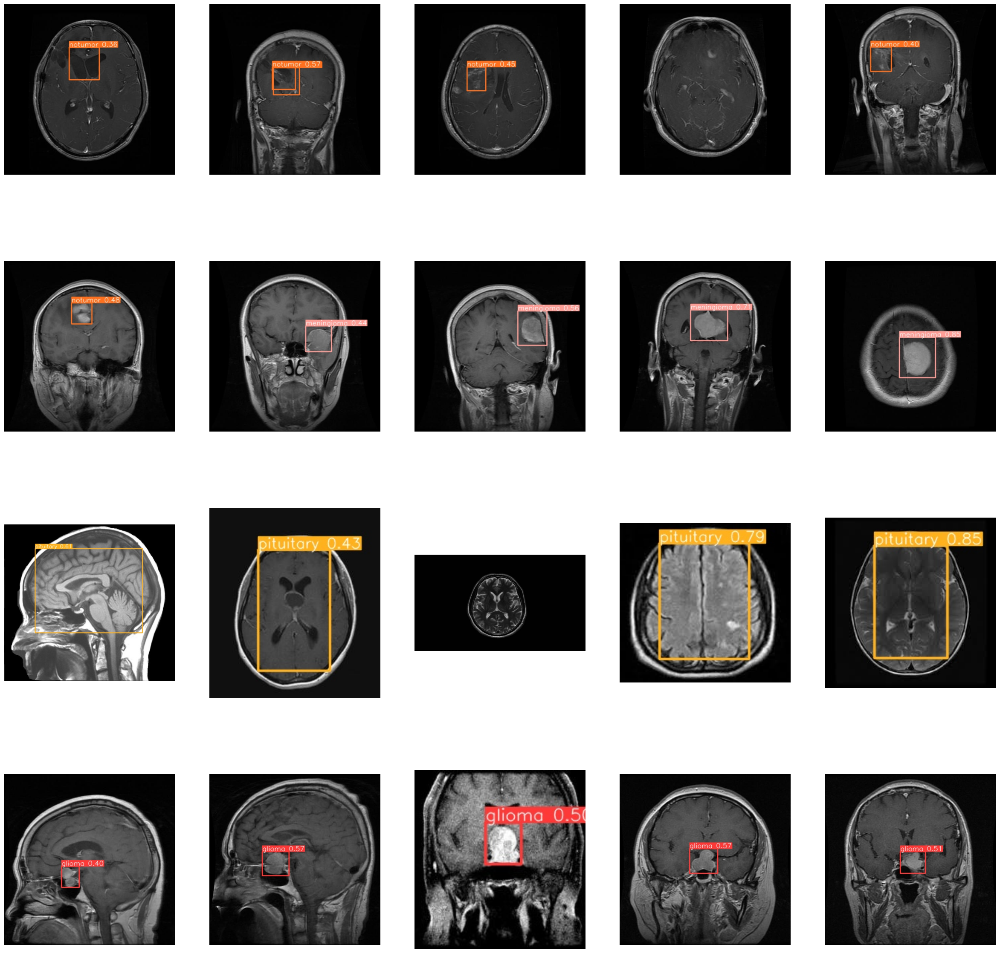

In [ ]:
dirs = ['/content/drive/MyDrive/brain_tumor_object_detection/inference_results/test_results_on_all_images/glioma/detect/predict',
        '/content/drive/MyDrive/brain_tumor_object_detection/inference_results/test_results_on_all_images/meningioma/detect/predict',
        '/content/drive/MyDrive/brain_tumor_object_detection/inference_results/test_results_on_all_images/notumor/detect/predict',
        '/content/drive/MyDrive/brain_tumor_object_detection/inference_results/test_results_on_all_images/pituitary/detect/predict']

all_images = []
for directory in dirs:
    random_images = get_random_images_from_dir(directory, num_images=5)
    all_images.extend(random_images)

display_images(all_images)

## YOLOv8n Adamax

### Modelling

In [ ]:
yolov8n_btd_model_adamax = YOLO('yolov8n.yaml')
yolov8n_btd_model_adamax_results = yolov8n_btd_model_adamax.train(data = '/content/drive/MyDrive/brain_tumor_object_detection/brain_tumor_dataset.yaml',
                                                    epochs = 30,
                                                    batch = 32,
                                                    name = 'YOLOv8n_Adamax',
                                                    optimizer = 'Adamax',
                                                    lr0 = 0.001,
                                                    lrf = 0.001,
                                                    momentum = 0.85,
                                                    dropout = 0.5
                                                    )

Ultralytics YOLOv8.1.4 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.yaml, data=/content/drive/MyDrive/brain_tumor_object_detection/brain_tumor_dataset.yaml, epochs=30, time=None, patience=50, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=YOLOv8n_Adamax, exist_ok=False, pretrained=True, optimizer=Adamax, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.5, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=Fa

train: Scanning /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/train/glioma.cache... 1740 images, 2 backgrounds, 0 corrupt: 100%|██████████| 1740/1740 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/glioma.cache... 431 images, 4 backgrounds, 0 corrupt: 100%|██████████| 435/435 [00:00<?, ?it/s]


Plotting labels to runs/detect/YOLOv8n_Adamax/labels.jpg... 
optimizer: Adamax(lr=0.001, momentum=0.85) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/YOLOv8n_Adamax
Starting training for 30 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/30      4.92G      3.349      4.561      3.606         23        640: 100%|██████████| 55/55 [00:46<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:06<00:00,  1.16it/s]

                   all        435        435   0.000429      0.239     0.0071    0.00257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/30      4.51G      3.017      3.636      3.127         24        640: 100%|██████████| 55/55 [00:44<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.22it/s]

                   all        435        435      0.545     0.0636      0.065     0.0239



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/30      4.51G      2.772      3.051      2.968         19        640: 100%|██████████| 55/55 [00:44<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.25it/s]

                   all        435        435      0.524      0.261      0.255     0.0848



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/30      4.51G      2.423      2.663      2.699         25        640: 100%|██████████| 55/55 [00:43<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:06<00:00,  1.04it/s]

                   all        435        435      0.561      0.363      0.345      0.152



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/30      4.51G      2.235      2.366      2.528         20        640: 100%|██████████| 55/55 [00:41<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.18s/it]

                   all        435        435      0.693      0.488      0.533      0.263



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/30      4.51G      2.093      2.108      2.371         22        640: 100%|██████████| 55/55 [00:42<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.15s/it]

                   all        435        435       0.57      0.538      0.595      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/30      4.51G      1.982      1.934      2.276         19        640: 100%|██████████| 55/55 [00:42<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:06<00:00,  1.05it/s]

                   all        435        435      0.582       0.55      0.587      0.305



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/30       4.5G      1.908      1.791      2.174         19        640: 100%|██████████| 55/55 [00:44<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.29it/s]

                   all        435        435      0.648      0.556      0.611      0.324



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/30      4.51G      1.834      1.719      2.128         21        640: 100%|██████████| 55/55 [00:44<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.28it/s]

                   all        435        435       0.55      0.638      0.649      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/30       4.5G       1.78      1.608      2.077         20        640: 100%|██████████| 55/55 [00:44<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:06<00:00,  1.13it/s]

                   all        435        435      0.716      0.674      0.714      0.388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/30      4.51G       1.78      1.588      2.035         22        640: 100%|██████████| 55/55 [00:42<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.04s/it]

                   all        435        435      0.689      0.639      0.709      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/30      4.51G      1.705       1.49      1.983         23        640: 100%|██████████| 55/55 [00:41<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.08s/it]

                   all        435        435      0.745      0.654      0.728      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/30      4.51G      1.687      1.461      1.947         20        640: 100%|██████████| 55/55 [00:42<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.26s/it]

                   all        435        435      0.673      0.697      0.714      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/30       4.5G      1.682      1.454      1.931         24        640: 100%|██████████| 55/55 [00:42<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.06s/it]

                   all        435        435      0.751       0.71      0.763       0.42



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/30      4.51G      1.634      1.374      1.893         22        640: 100%|██████████| 55/55 [00:45<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.23it/s]

                   all        435        435      0.699      0.723      0.757      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/30       4.5G      1.615      1.363      1.892         29        640: 100%|██████████| 55/55 [00:44<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:06<00:00,  1.01it/s]

                   all        435        435      0.712      0.722      0.752      0.418



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/30      4.51G      1.602      1.322      1.862         26        640: 100%|██████████| 55/55 [00:43<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.07s/it]

                   all        435        435      0.801      0.718      0.787      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/30       4.5G      1.586      1.321      1.843         18        640: 100%|██████████| 55/55 [00:42<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.22s/it]

                   all        435        435      0.792      0.734      0.813      0.451



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/30      4.51G      1.592      1.285      1.837         19        640: 100%|██████████| 55/55 [00:43<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:06<00:00,  1.13it/s]

                   all        435        435      0.756      0.756      0.798      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/30       4.5G      1.574      1.282      1.828         18        640: 100%|██████████| 55/55 [00:44<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:06<00:00,  1.06it/s]

                   all        435        435      0.729      0.754      0.795      0.451


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/30      4.89G      1.547      1.213      1.908         13        640: 100%|██████████| 55/55 [00:46<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.00s/it]

                   all        435        435      0.792       0.73      0.803      0.443



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/30       4.5G      1.505      1.147      1.861         13        640: 100%|██████████| 55/55 [00:41<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.09s/it]

                   all        435        435       0.71      0.761       0.79      0.443



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/30      4.51G      1.478      1.118      1.841         12        640: 100%|██████████| 55/55 [00:40<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.26s/it]

                   all        435        435      0.849      0.753      0.831      0.462



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/30       4.5G      1.444      1.064      1.825         14        640: 100%|██████████| 55/55 [00:40<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.18s/it]

                   all        435        435      0.794      0.771      0.827      0.477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/30      4.51G       1.43      1.033      1.804         12        640: 100%|██████████| 55/55 [00:40<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.18s/it]

                   all        435        435      0.819       0.75      0.829      0.483



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/30       4.5G      1.425      1.028      1.811         12        640: 100%|██████████| 55/55 [00:40<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.13s/it]

                   all        435        435      0.758      0.826      0.836      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/30      4.51G      1.412      1.006      1.781         12        640: 100%|██████████| 55/55 [00:40<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.14s/it]

                   all        435        435      0.841      0.765      0.835      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/30       4.5G      1.408     0.9821      1.774         12        640: 100%|██████████| 55/55 [00:41<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.02s/it]

                   all        435        435      0.839      0.731      0.837      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/30      4.51G      1.384     0.9705      1.763         12        640: 100%|██████████| 55/55 [00:41<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.00s/it]

                   all        435        435       0.84      0.786      0.847       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/30       4.5G      1.383     0.9601      1.762         12        640: 100%|██████████| 55/55 [00:41<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.01s/it]

                   all        435        435      0.844      0.806      0.851      0.494



30 epochs completed in 0.433 hours.
Optimizer stripped from runs/detect/YOLOv8n_Adamax/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/YOLOv8n_Adamax/weights/best.pt, 6.2MB

Validating runs/detect/YOLOv8n_Adamax/weights/best.pt...
Ultralytics YOLOv8.1.4 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8n summary (fused): 168 layers, 3006428 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:11<00:00,  1.58s/it]


                   all        435        435      0.845      0.806      0.851      0.494
                glioma        435        125      0.804       0.92      0.925      0.452
            meningioma        435        110      0.951      0.855      0.937      0.567
               notumor        435         90      0.707      0.536      0.565      0.238
             pituitary        435        110      0.918      0.914      0.977      0.721
Speed: 0.2ms preprocess, 2.6ms inference, 0.0ms loss, 5.6ms postprocess per image
Results saved to runs/detect/YOLOv8n_Adamax


### Performance Metrics

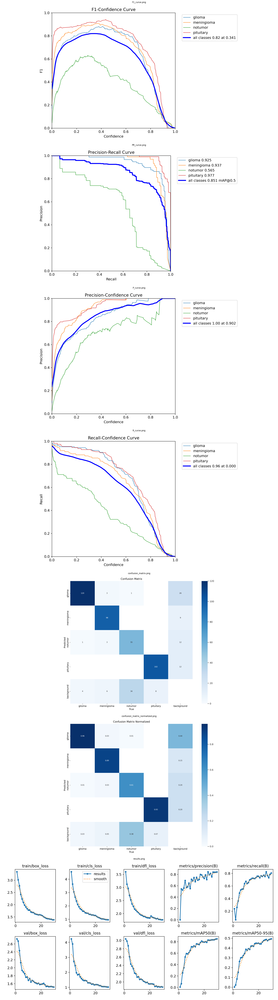

In [ ]:
image_paths = [
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8n_Adamax/detect/YOLOv8n_Adamax/F1_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8n_Adamax/detect/YOLOv8n_Adamax/PR_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8n_Adamax/detect/YOLOv8n_Adamax/P_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8n_Adamax/detect/YOLOv8n_Adamax/R_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8n_Adamax/detect/YOLOv8n_Adamax/confusion_matrix.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8n_Adamax/detect/YOLOv8n_Adamax/confusion_matrix_normalized.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8n_Adamax/detect/YOLOv8n_Adamax/results.png',
]
plot_images(image_paths)

### Testing

In [ ]:
def predict_results_on_YOLOv8n_Adamax(test_images_dir):
    model = YOLO('/content/drive/MyDrive/brain_tumor_object_detection/yolov8n_Adamax/detect/YOLOv8n_Adamax/weights/best.pt')

    image_files = [f for f in os.listdir(test_images_dir) if f.lower().endswith('.jpg')]

    for image_file in image_files:
        image_path = os.path.join(test_images_dir, image_file)
        model.predict(image_path, save=True, imgsz=512, conf=0.3)

In [ ]:
test_dir = '/content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images'
predict_results_on_YOLOv8m_Adam(test_dir)


image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images/Copy of Tr-gl_0045.jpg: 512x512 1 notumor, 17.1ms
Speed: 1.6ms preprocess, 17.1ms inference, 2.3ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images/Copy of Tr-gl_0037.jpg: 512x512 1 notumor, 18.7ms
Speed: 1.5ms preprocess, 18.7ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images/Copy of Tr-gl_0029.jpg: 512x512 (no detections), 23.3ms
Speed: 1.6ms preprocess, 23.3ms inference, 0.8ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images/Copy of Tr

In [ ]:
def display_images(images, num_images_per_row=5):
    fig, axs = plt.subplots(len(images) // num_images_per_row, num_images_per_row, figsize=(30, 30))
    axs = axs.flatten()

    for i, img_path in enumerate(images):
        img = mpimg.imread(img_path)
        axs[i].imshow(img)
        axs[i].axis('off')

    plt.show()

In [ ]:
def get_random_images_from_dir(directory, num_images=5):
    all_images = [f for f in os.listdir(directory) if f.lower().endswith('.jpg')]
    random_images = random.sample(all_images, min(num_images, len(all_images)))
    return [os.path.join(directory, img) for img in random_images]

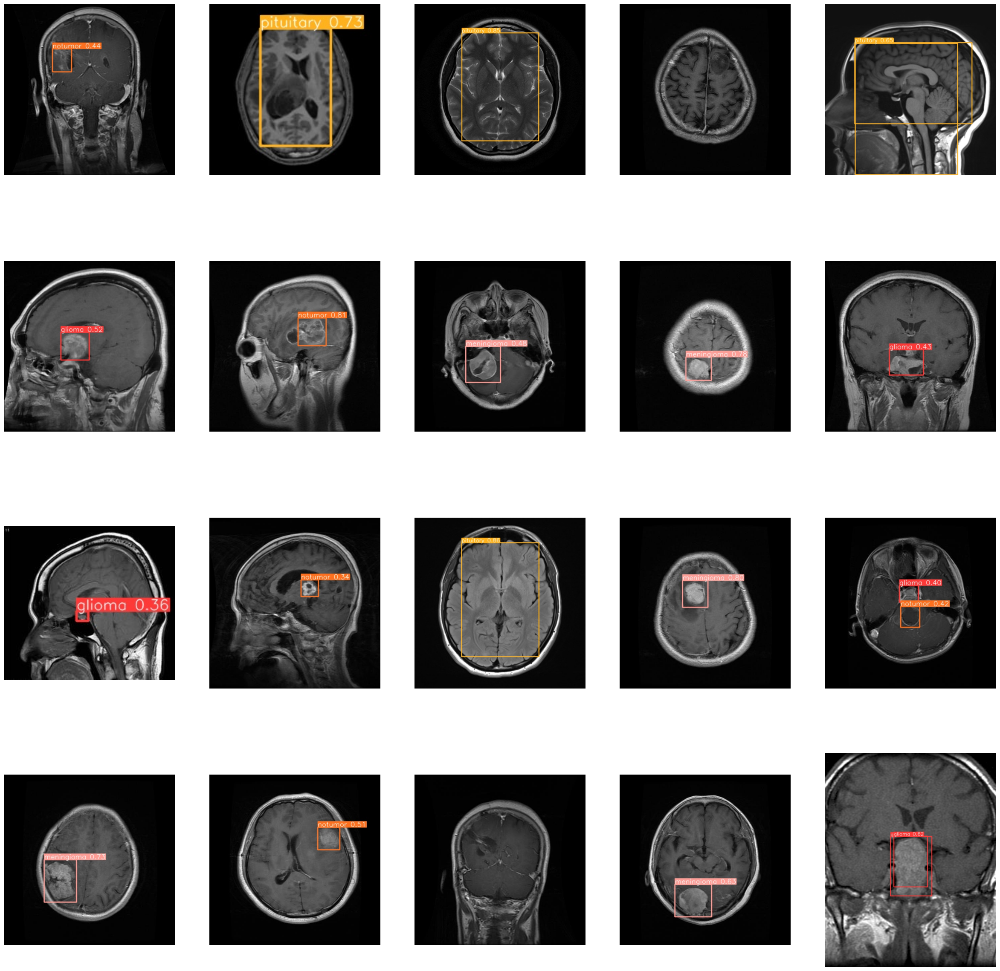

In [ ]:
random_images = get_random_images_from_dir('/content/drive/MyDrive/brain_tumor_object_detection/yolov8n_Adamax_test_results/detect/predict', 20)
display_images(random_images)

## YOLOv8m RMSProp

### Modelling

In [ ]:
yolov8m_btd_model = YOLO('yolov8m.yaml')
yolov8m_btd_model_results = yolov8m_btd_model.train(data = '/content/drive/MyDrive/brain_tumor_object_detection/brain_tumor_dataset.yaml',
                                                    epochs = 30,
                                                    batch = 32,
                                                    name = 'YOLOv8m',
                                                    optimizer = 'RMSProp',
                                                    lr0 = 0.001,
                                                    lrf = 0.001,
                                                    momentum = 0.90,
                                                    dropout = 0.2
                                                    )

Ultralytics YOLOv8.1.3 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.yaml, data=/content/drive/MyDrive/brain_tumor_object_detection/brain_tumor_dataset.yaml, epochs=30, time=None, patience=50, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=YOLOv8m5, exist_ok=False, pretrained=True, optimizer=RMSProp, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.2, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, 

train: Scanning /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/train/glioma.cache... 1740 images, 2 backgrounds, 0 corrupt: 100%|██████████| 1740/1740 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/glioma.cache... 431 images, 4 backgrounds, 0 corrupt: 100%|██████████| 435/435 [00:00<?, ?it/s]


Plotting labels to runs/detect/YOLOv8m5/labels.jpg... 
optimizer: RMSprop(lr=0.001, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/YOLOv8m5
Starting training for 30 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/30        14G      3.394      4.504      3.975         23        640: 100%|██████████| 55/55 [01:00<00:00,  1.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.03s/it]

                   all        435        435   1.64e-05    0.00909   9.23e-06   2.02e-06



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/30      13.7G      2.988      3.901       3.33         24        640: 100%|██████████| 55/55 [00:53<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:06<00:00,  1.06it/s]

                   all        435        435   1.64e-05    0.00909   9.23e-06   2.02e-06



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/30      13.7G      2.814      3.505      3.138         19        640: 100%|██████████| 55/55 [00:55<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.05s/it]

                   all        435        435   1.64e-05    0.00909   9.23e-06   2.02e-06



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/30      13.7G      2.697      3.412      3.032         25        640: 100%|██████████| 55/55 [00:57<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:06<00:00,  1.02it/s]

                   all        435        435      0.121     0.0386     0.0758     0.0265



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/30      14.2G       2.54      3.262      2.895         20        640: 100%|██████████| 55/55 [00:55<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:09<00:00,  1.35s/it]

                   all        435        435       0.75     0.0705   0.000626   0.000196



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/30      14.2G       2.45      3.198       2.82         22        640: 100%|██████████| 55/55 [00:54<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.16s/it]

                   all        435        435   0.000821      0.241    0.00195   0.000608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/30      14.2G      2.417      3.117      2.798         19        640: 100%|██████████| 55/55 [00:54<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.14s/it]

                   all        435        435    0.00032      0.048   0.000216   5.74e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/30      14.2G      2.374      3.086      2.723         19        640: 100%|██████████| 55/55 [00:54<00:00,  1.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.13s/it]

                   all        435        435     0.0819      0.208     0.0656     0.0205



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/30      13.7G      2.302       2.99      2.692         21        640: 100%|██████████| 55/55 [00:54<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:09<00:00,  1.38s/it]

                   all        435        435      0.561       0.09     0.0544     0.0133



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/30      14.2G       2.26      2.915      2.665         20        640: 100%|██████████| 55/55 [00:55<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:18<00:00,  2.60s/it]

                   all        435        435      0.782       0.05     0.0184    0.00555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/30      13.7G      2.272      2.903      2.632         22        640: 100%|██████████| 55/55 [00:54<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.06s/it]

                   all        435        435      0.592      0.066      0.109     0.0412



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/30      14.2G      2.204        2.8      2.607         23        640: 100%|██████████| 55/55 [00:55<00:00,  1.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:19<00:00,  2.83s/it]

                   all        435        435     0.0123        0.3     0.0207    0.00681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/30      13.8G      2.186       2.69      2.586         20        640: 100%|██████████| 55/55 [00:54<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.15s/it]

                   all        435        435      0.525     0.0205     0.0732     0.0154



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/30      14.2G      2.228      2.692      2.622         24        640: 100%|██████████| 55/55 [00:55<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:14<00:00,  2.04s/it]

                   all        435        435      0.294      0.132      0.026     0.0067



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/30      13.8G      2.143        2.6      2.542         22        640: 100%|██████████| 55/55 [00:54<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.13s/it]

                   all        435        435       0.35      0.327      0.198     0.0742



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/30      13.7G      2.089      2.475      2.494         29        640: 100%|██████████| 55/55 [00:54<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:06<00:00,  1.01it/s]

                   all        435        435      0.439     0.0468     0.0615     0.0226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/30      13.7G       2.09      2.423      2.493         26        640: 100%|██████████| 55/55 [00:55<00:00,  1.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.07s/it]

                   all        435        435      0.693     0.0231     0.0746      0.035



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/30      14.2G      2.059      2.352      2.447         18        640: 100%|██████████| 55/55 [00:54<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.07s/it]

                   all        435        435     0.0253      0.147     0.0299     0.0083



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/30      13.8G      2.026      2.284      2.447         19        640: 100%|██████████| 55/55 [00:55<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.19s/it]

                   all        435        435       0.55      0.016      0.039     0.0147



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/30      14.2G      2.004      2.245      2.419         18        640: 100%|██████████| 55/55 [00:54<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.21s/it]

                   all        435        435      0.114      0.175      0.102     0.0374


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/30      13.7G      1.965      2.285      2.517         13        640: 100%|██████████| 55/55 [00:56<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.17s/it]

                   all        435        435      0.273     0.0409     0.0148    0.00398



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/30      14.2G      1.916      1.984      2.427         13        640: 100%|██████████| 55/55 [00:54<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:10<00:00,  1.53s/it]

                   all        435        435      0.203      0.223     0.0278     0.0105



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/30      13.7G      1.923      1.955      2.439         12        640: 100%|██████████| 55/55 [00:53<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.14s/it]

                   all        435        435      0.333      0.108      0.153     0.0695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/30      14.2G      1.889      1.904      2.419         14        640: 100%|██████████| 55/55 [00:54<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.18s/it]

                   all        435        435      0.579      0.256      0.393      0.173



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/30      13.7G       1.88      1.852      2.415         12        640: 100%|██████████| 55/55 [00:53<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.17s/it]

                   all        435        435      0.565       0.42      0.315      0.129



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/30      13.7G      1.877      1.831      2.385         12        640: 100%|██████████| 55/55 [00:53<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.17s/it]

                   all        435        435      0.755      0.377      0.463      0.204



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/30      13.7G      1.812       1.75      2.353         12        640: 100%|██████████| 55/55 [00:54<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.03s/it]

                   all        435        435      0.479      0.453      0.477      0.201



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/30      14.2G      1.834      1.729      2.351         12        640: 100%|██████████| 55/55 [00:53<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.13s/it]

                   all        435        435      0.294      0.428      0.317      0.122



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/30      14.2G      1.787      1.706      2.324         12        640: 100%|██████████| 55/55 [00:54<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.17s/it]

                   all        435        435      0.444      0.213      0.295      0.139



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/30      14.2G      1.788      1.625      2.309         12        640: 100%|██████████| 55/55 [00:53<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.24s/it]

                   all        435        435      0.549      0.488      0.536      0.268



30 epochs completed in 0.561 hours.
Optimizer stripped from runs/detect/YOLOv8m5/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/YOLOv8m5/weights/best.pt, 52.0MB

Validating runs/detect/YOLOv8m5/weights/best.pt...
Ultralytics YOLOv8.1.3 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8m summary (fused): 218 layers, 25842076 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:12<00:00,  1.72s/it]


                   all        435        435      0.547      0.485      0.535      0.268
                glioma        435        125      0.487        0.8      0.747      0.314
            meningioma        435        110      0.806      0.414      0.656      0.336
               notumor        435         90      0.445      0.187      0.192     0.0672
             pituitary        435        110      0.451      0.537      0.546      0.354
Speed: 0.3ms preprocess, 10.9ms inference, 0.0ms loss, 6.1ms postprocess per image
Results saved to runs/detect/YOLOv8m5


### Performance Metrics

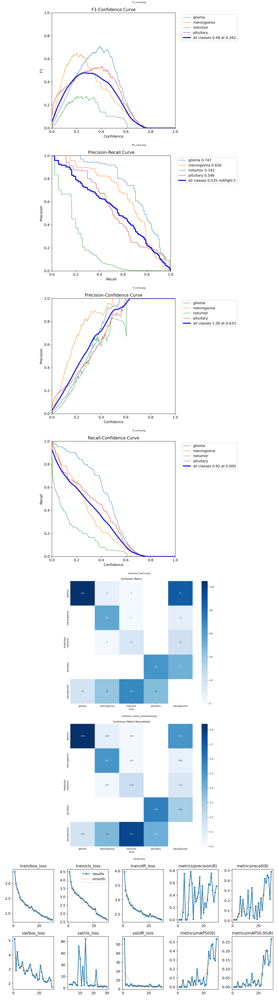

In [ ]:
image_paths = [
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m/detect/YOLOv8m5/F1_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m/detect/YOLOv8m5/PR_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m/detect/YOLOv8m5/P_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m/detect/YOLOv8m5/R_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m/detect/YOLOv8m5/confusion_matrix.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m/detect/YOLOv8m5/confusion_matrix_normalized.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m/detect/YOLOv8m5/results.png',
]
plot_images(image_paths)

### Testing

In [ ]:
def predict_results_on_YOLOv8m(test_images_dir):
    model = YOLO('/content/drive/MyDrive/brain_tumor_object_detection/yolov8m/detect/YOLOv8m5/weights/best.pt')
    # os.makedirs(output_dir, exist_ok=True)

    image_files = [f for f in os.listdir(test_images_dir) if f.lower().endswith('.jpg')]

    for image_file in image_files:
        image_path = os.path.join(test_images_dir, image_file)
        model.predict(image_path, save=True, imgsz=512, conf=0.3)

In [ ]:
predict_results_on_YOLOv8m('/content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images')


image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images/Copy of Tr-gl_0045.jpg: 512x512 (no detections), 42.9ms
Speed: 1.4ms preprocess, 42.9ms inference, 0.9ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images/Copy of Tr-gl_0037.jpg: 512x512 (no detections), 39.9ms
Speed: 1.4ms preprocess, 39.9ms inference, 0.9ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images/Copy of Tr-gl_0029.jpg: 512x512 (no detections), 40.4ms
Speed: 1.3ms preprocess, 40.4ms inference, 0.9ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_image

In [ ]:
def get_random_images_from_dir(directory, num_images=5):
    all_images = [f for f in os.listdir(directory) if f.lower().endswith('.jpg')]
    random_images = random.sample(all_images, min(num_images, len(all_images)))
    return [os.path.join(directory, img) for img in random_images]

In [ ]:
def display_images(images, num_images_per_row=5):
    fig, axs = plt.subplots(len(images) // num_images_per_row, num_images_per_row, figsize=(30, 30))
    axs = axs.flatten()

    for i, img_path in enumerate(images):
        img = mpimg.imread(img_path)
        axs[i].imshow(img)
        axs[i].axis('off')

    plt.show()

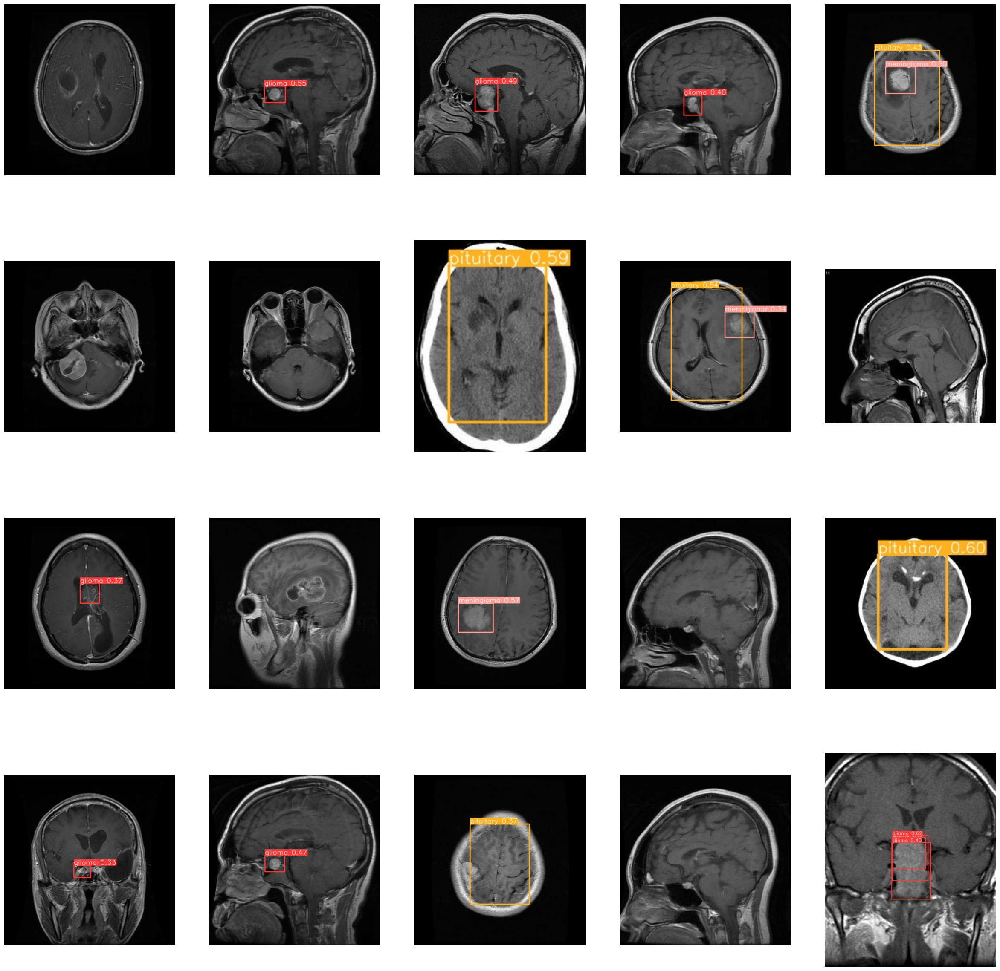

In [ ]:
random_images = get_random_images_from_dir('/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_test_reults/detect/predict', 20)
display_images(random_images)

## YOLOv8m Adam

### Modelling

In [ ]:
yolov8m_btd_model_optimized = YOLO('yolov8m.yaml')
yolov8m_btd_model_optimized_results = yolov8m_btd_model_optimized.train(data = '/content/drive/MyDrive/brain_tumor_object_detection/brain_tumor_dataset.yaml',
                                                    epochs = 30,
                                                    batch = 32,
                                                    name = 'YOLOv8m',
                                                    optimizer = 'Adam',
                                                    lr0 = 0.001,
                                                    lrf = 0.001,
                                                    momentum = 0.90,
                                                    dropout = 0.3
                                                    )

Ultralytics YOLOv8.1.3 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.yaml, data=/content/drive/MyDrive/brain_tumor_object_detection/brain_tumor_dataset.yaml, epochs=30, time=None, patience=50, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=YOLOv8m, exist_ok=False, pretrained=True, optimizer=Adam, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.3, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save

100%|██████████| 755k/755k [00:00<00:00, 15.7MB/s]


Overriding model.yaml nc=80 with nc=4

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytics

100%|██████████| 6.23M/6.23M [00:00<00:00, 65.5MB/s]


WARNING ⚠️ NMS time limit 0.550s exceeded
AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/train/glioma.cache... 1740 images, 2 backgrounds, 0 corrupt: 100%|██████████| 1740/1740 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/glioma.cache... 431 images, 4 backgrounds, 0 corrupt: 100%|██████████| 435/435 [00:00<?, ?it/s]


Plotting labels to runs/detect/YOLOv8m/labels.jpg... 
optimizer: Adam(lr=0.001, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/YOLOv8m
Starting training for 30 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/30        14G      3.259      4.253      3.502         23        640: 100%|██████████| 55/55 [02:40<00:00,  2.91s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:24<00:00,  3.48s/it]

                   all        435        435   0.000392      0.234     0.0191     0.0059



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/30      14.2G      2.628      2.827      2.855         24        640: 100%|██████████| 55/55 [00:54<00:00,  1.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.00s/it]

                   all        435        435      0.559      0.159     0.0409      0.011



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/30      13.7G      2.226      2.274      2.535         19        640: 100%|██████████| 55/55 [00:56<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.03s/it]

                   all        435        435      0.573      0.134     0.0899     0.0306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/30      14.2G      2.006      1.983      2.329         25        640: 100%|██████████| 55/55 [00:55<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.02s/it]

                   all        435        435      0.377      0.441      0.368      0.149



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/30      14.2G      1.915      1.858      2.196         20        640: 100%|██████████| 55/55 [00:57<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.07s/it]

                   all        435        435      0.648      0.564       0.62      0.333



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/30      14.2G      1.812      1.711      2.091         22        640: 100%|██████████| 55/55 [00:55<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.14s/it]

                   all        435        435      0.594      0.583      0.646      0.334



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/30      14.2G       1.76      1.613      2.043         19        640: 100%|██████████| 55/55 [00:56<00:00,  1.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.17s/it]

                   all        435        435      0.554      0.582      0.637      0.337



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/30      14.2G      1.727      1.549      1.971         19        640: 100%|██████████| 55/55 [00:56<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.02s/it]

                   all        435        435      0.599      0.634      0.675      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/30      13.7G      1.697      1.518      1.966         21        640: 100%|██████████| 55/55 [00:57<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.03s/it]

                   all        435        435       0.65      0.652      0.684      0.365



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/30      14.2G      1.655       1.46      1.936         20        640: 100%|██████████| 55/55 [00:58<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.04s/it]

                   all        435        435      0.702      0.617       0.67      0.381



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/30      14.2G      1.655      1.448      1.912         22        640: 100%|██████████| 55/55 [00:56<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.18s/it]

                   all        435        435      0.753      0.715      0.786      0.425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/30      14.2G      1.613      1.344      1.871         23        640: 100%|██████████| 55/55 [00:56<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.19s/it]

                   all        435        435      0.806      0.683      0.781      0.425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/30      13.7G      1.596      1.315      1.858         20        640: 100%|██████████| 55/55 [00:56<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.05s/it]

                   all        435        435       0.71      0.703      0.749      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/30      14.2G      1.592      1.315      1.847         24        640: 100%|██████████| 55/55 [00:56<00:00,  1.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.06s/it]

                   all        435        435      0.743      0.688      0.745      0.421



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/30      13.7G       1.55       1.26       1.82         22        640: 100%|██████████| 55/55 [00:58<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.19s/it]

                   all        435        435      0.732      0.732      0.797      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/30      14.2G      1.525      1.222      1.806         29        640: 100%|██████████| 55/55 [00:56<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.19s/it]

                   all        435        435      0.824      0.715      0.808      0.462



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/30      13.7G      1.525      1.166      1.785         26        640: 100%|██████████| 55/55 [00:57<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:09<00:00,  1.36s/it]

                   all        435        435      0.724      0.702      0.791      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/30      13.7G      1.489      1.171      1.756         18        640: 100%|██████████| 55/55 [00:57<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.09s/it]

                   all        435        435      0.792      0.744      0.811      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/30      13.7G      1.515      1.145      1.771         19        640: 100%|██████████| 55/55 [00:57<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.01s/it]

                   all        435        435      0.792      0.697      0.819       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/30      13.7G       1.49      1.137      1.753         18        640: 100%|██████████| 55/55 [00:58<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:06<00:00,  1.00it/s]

                   all        435        435      0.756      0.732      0.799      0.455


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/30      14.2G      1.498      1.063       1.92         13        640: 100%|██████████| 55/55 [00:59<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.20s/it]

                   all        435        435      0.834      0.781      0.856      0.477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/30      14.2G      1.471     0.9852      1.889         13        640: 100%|██████████| 55/55 [00:57<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.26s/it]

                   all        435        435      0.818      0.758      0.839      0.471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/30      13.7G      1.444     0.9597      1.871         12        640: 100%|██████████| 55/55 [00:57<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.04s/it]

                   all        435        435      0.866      0.779      0.862      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/30      14.2G      1.423     0.9092      1.855         14        640: 100%|██████████| 55/55 [00:56<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.06s/it]

                   all        435        435       0.89      0.789      0.881      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/30      13.7G      1.384     0.8605      1.826         12        640: 100%|██████████| 55/55 [00:57<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.15s/it]

                   all        435        435      0.866      0.738      0.857      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/30      14.2G      1.364     0.8379      1.817         12        640: 100%|██████████| 55/55 [00:56<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:06<00:00,  1.02it/s]

                   all        435        435      0.861      0.815      0.896      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/30      14.2G      1.339     0.8031      1.775         12        640: 100%|██████████| 55/55 [00:56<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.18s/it]

                   all        435        435       0.84       0.84      0.889      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/30      14.2G      1.327     0.7712      1.766         12        640: 100%|██████████| 55/55 [00:56<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.09s/it]

                   all        435        435      0.844      0.847      0.911       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/30      13.7G       1.31     0.7539      1.747         12        640: 100%|██████████| 55/55 [00:56<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.25s/it]

                   all        435        435       0.89      0.798      0.896      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/30      14.2G      1.282     0.7327      1.726         12        640: 100%|██████████| 55/55 [00:56<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:06<00:00,  1.01it/s]

                   all        435        435      0.885       0.82      0.902      0.538



30 epochs completed in 0.609 hours.
Optimizer stripped from runs/detect/YOLOv8m/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/YOLOv8m/weights/best.pt, 52.0MB

Validating runs/detect/YOLOv8m/weights/best.pt...
Ultralytics YOLOv8.1.3 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8m summary (fused): 218 layers, 25842076 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:12<00:00,  1.80s/it]


                   all        435        435      0.844      0.847       0.91      0.549
                glioma        435        125      0.853      0.952      0.965      0.492
            meningioma        435        110      0.896      0.945      0.977      0.625
               notumor        435         90      0.811      0.544      0.719      0.334
             pituitary        435        110      0.817      0.945      0.978      0.747
Speed: 0.3ms preprocess, 10.4ms inference, 0.0ms loss, 4.2ms postprocess per image
Results saved to runs/detect/YOLOv8m


In [ ]:
test_dir = '/content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images'
predict_results_on_YOLOv8m(test_dir)


image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images/Copy of Tr-pi_0081.jpg: 320x320 (no detections), 16.1ms
Speed: 1.2ms preprocess, 16.1ms inference, 0.7ms postprocess per image at shape (1, 3, 320, 320)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images/Copy of Tr-pi_0077.jpg: 320x320 1 glioma, 16.3ms
Speed: 1.4ms preprocess, 16.3ms inference, 1.8ms postprocess per image at shape (1, 3, 320, 320)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images/Copy of Tr-pi_0049.jpg: 320x320 1 glioma, 16.2ms
Speed: 1.2ms preprocess, 16.2ms inference, 1.4ms postprocess per image at shape (1, 3, 320, 320)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images/Copy of Tr-p

### Performance Metrics

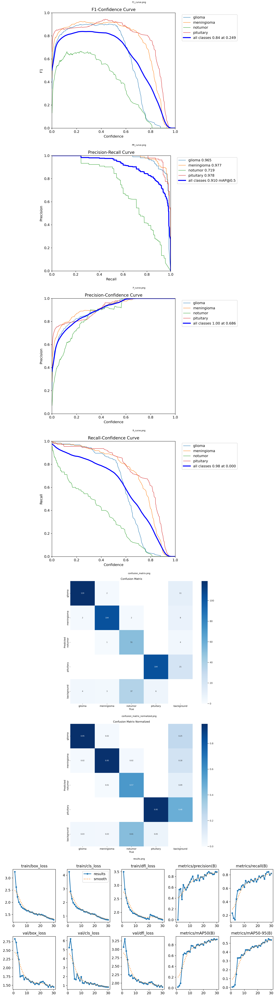

In [ ]:
image_paths = [
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adam/detect/YOLOv8m/F1_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adam/detect/YOLOv8m/PR_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adam/detect/YOLOv8m/P_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adam/detect/YOLOv8m/R_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adam/detect/YOLOv8m/confusion_matrix.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adam/detect/YOLOv8m/confusion_matrix_normalized.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adam/detect/YOLOv8m/results.png',
]
plot_images(image_paths)

### Testing

In [ ]:
def predict_results_on_YOLOv8m_Adam(test_images_dir):
    model = YOLO('/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adam/detect/YOLOv8m/weights/best.pt')
    # os.makedirs(output_dir, exist_ok=True)

    image_files = [f for f in os.listdir(test_images_dir) if f.lower().endswith('.jpg')]

    for image_file in image_files:
        image_path = os.path.join(test_images_dir, image_file)
        model.predict(image_path, save=True, imgsz=512, conf=0.3)

In [ ]:
test_dir = '/content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images'
predict_results_on_YOLOv8m_Adam(test_dir)


image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images/Copy of Tr-gl_0045.jpg: 512x512 1 notumor, 25.4ms
Speed: 1.1ms preprocess, 25.4ms inference, 1.4ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/detect/predict2

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images/Copy of Tr-gl_0037.jpg: 512x512 1 notumor, 25.5ms
Speed: 1.0ms preprocess, 25.5ms inference, 2.1ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/detect/predict2

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images/Copy of Tr-gl_0029.jpg: 512x512 (no detections), 25.7ms
Speed: 1.0ms preprocess, 25.7ms inference, 0.7ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/detect/predict2

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images/Copy of

In [ ]:
def display_images(images, num_images_per_row=5):
    fig, axs = plt.subplots(len(images) // num_images_per_row, num_images_per_row, figsize=(30, 30))
    axs = axs.flatten()

    for i, img_path in enumerate(images):
        img = mpimg.imread(img_path)
        axs[i].imshow(img)
        axs[i].axis('off')

    plt.show()

In [ ]:
def get_random_images_from_dir(directory, num_images=5):
    all_images = [f for f in os.listdir(directory) if f.lower().endswith('.jpg')]
    random_images = random.sample(all_images, min(num_images, len(all_images)))
    return [os.path.join(directory, img) for img in random_images]

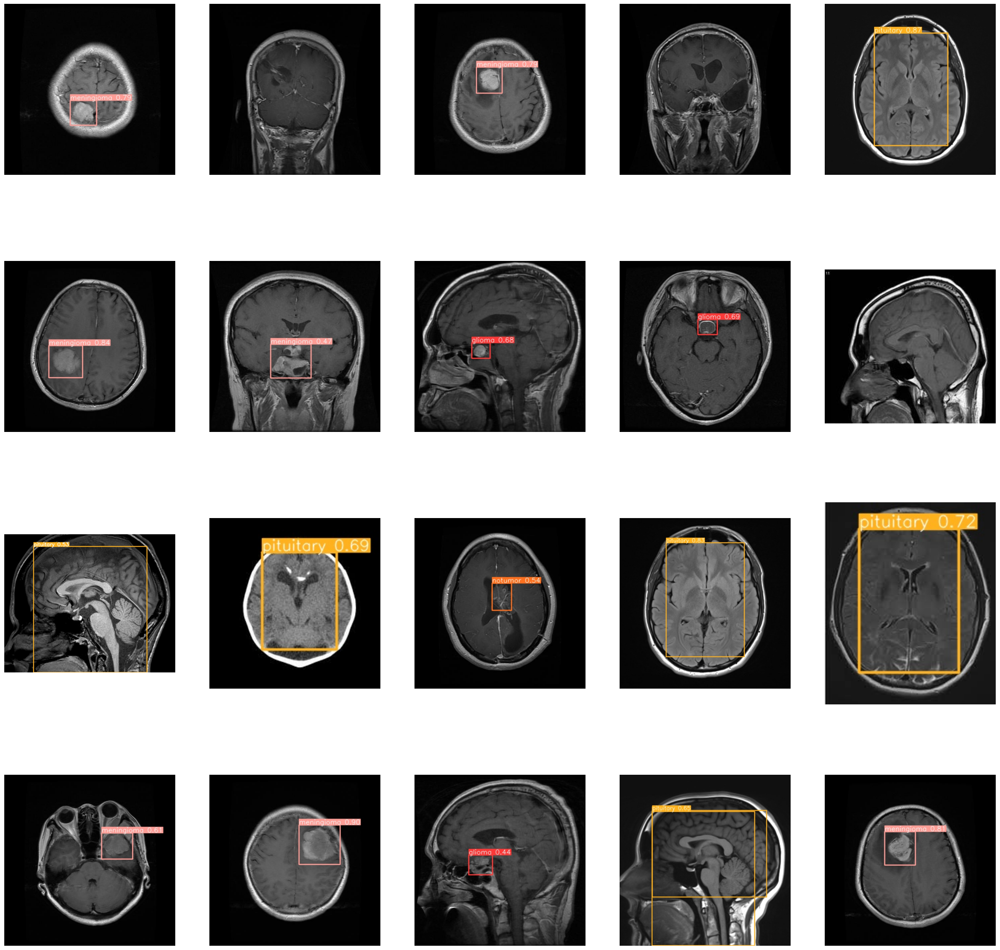

In [ ]:
random_images = get_random_images_from_dir('/content/drive/MyDrive/brain_tumor_object_detection/YOLOv8_Adam_test_reults/detect/predict2', 20)
display_images(random_images)

## YOLOv8m Adamax

### Modelling

In [ ]:
yolov8m_btd_model_adamax = YOLO('yolov8m.yaml')
yolov8m_btd_model_adamax_results = yolov8m_btd_model_adamax.train(data = '/content/drive/MyDrive/brain_tumor_object_detection/brain_tumor_dataset.yaml',
                                                    epochs = 30,
                                                    batch = 32,
                                                    name = 'YOLOv8m_Adamax',
                                                    optimizer = 'Adamax',
                                                    lr0 = 0.001,
                                                    lrf = 0.001,
                                                    momentum = 0.89,
                                                    dropout = 0.4
                                                    )

Ultralytics YOLOv8.1.4 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.yaml, data=/content/drive/MyDrive/brain_tumor_object_detection/brain_tumor_dataset.yaml, epochs=30, time=None, patience=50, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=YOLOv8m_Adamax, exist_ok=False, pretrained=True, optimizer=Adamax, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.4, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=Fa

100%|██████████| 755k/755k [00:00<00:00, 38.2MB/s]


Overriding model.yaml nc=80 with nc=4

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytics

100%|██████████| 6.23M/6.23M [00:00<00:00, 22.5MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/train/glioma.cache... 1740 images, 2 backgrounds, 0 corrupt: 100%|██████████| 1740/1740 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/glioma.cache... 431 images, 4 backgrounds, 0 corrupt: 100%|██████████| 435/435 [00:00<?, ?it/s]


Plotting labels to runs/detect/YOLOv8m_Adamax/labels.jpg... 
optimizer: Adamax(lr=0.001, momentum=0.89) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/YOLOv8m_Adamax
Starting training for 30 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/30        14G      3.366      4.481      3.649         23        640: 100%|██████████| 55/55 [06:15<00:00,  6.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:32<00:00,  4.69s/it]

                   all        435        435   0.000766      0.239     0.0117    0.00508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/30      14.2G      2.892      3.256      3.095         24        640: 100%|██████████| 55/55 [00:56<00:00,  1.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.20s/it]

                   all        435        435      0.788     0.0773      0.035    0.00938



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/30      13.7G      2.449      2.473      2.794         19        640: 100%|██████████| 55/55 [00:55<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.19s/it]

                   all        435        435      0.693      0.225      0.293     0.0993



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/30      14.2G      2.112      2.043      2.494         25        640: 100%|██████████| 55/55 [00:55<00:00,  1.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.27s/it]

                   all        435        435       0.56      0.489      0.527      0.259



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/30      13.7G      1.977      1.854       2.31         20        640: 100%|██████████| 55/55 [00:55<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.19s/it]

                   all        435        435      0.541      0.443      0.473      0.249



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/30      14.2G      1.834       1.67      2.174         22        640: 100%|██████████| 55/55 [00:55<00:00,  1.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.26s/it]

                   all        435        435       0.67       0.62      0.698       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/30      14.2G      1.781      1.557      2.102         19        640: 100%|██████████| 55/55 [00:56<00:00,  1.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.21s/it]

                   all        435        435      0.571      0.679      0.674      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/30      14.2G      1.715      1.464       2.02         19        640: 100%|██████████| 55/55 [00:55<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.28s/it]

                   all        435        435       0.75      0.657      0.744      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/30      14.2G      1.676      1.402      1.986         21        640: 100%|██████████| 55/55 [00:56<00:00,  1.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.04s/it]

                   all        435        435      0.706      0.691      0.762      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/30      14.2G      1.635      1.321      1.955         20        640: 100%|██████████| 55/55 [00:56<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.02s/it]

                   all        435        435      0.782      0.644      0.751      0.413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/30      13.7G       1.63      1.329      1.921         22        640: 100%|██████████| 55/55 [00:56<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.05s/it]

                   all        435        435      0.722      0.735      0.781       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/30      14.2G      1.581      1.244       1.88         23        640: 100%|██████████| 55/55 [00:55<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.13s/it]

                   all        435        435       0.84      0.707      0.807      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/30      14.2G      1.557        1.2      1.852         20        640: 100%|██████████| 55/55 [00:58<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.23s/it]

                   all        435        435      0.831      0.769       0.84      0.473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/30      14.2G      1.556      1.209       1.85         24        640: 100%|██████████| 55/55 [00:56<00:00,  1.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:08<00:00,  1.21s/it]

                   all        435        435      0.849      0.725      0.847      0.474



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/30      13.7G      1.507      1.139      1.802         22        640: 100%|██████████| 55/55 [00:56<00:00,  1.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.08s/it]

                   all        435        435      0.819      0.766      0.852      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/30      14.2G      1.488      1.111      1.798         29        640: 100%|██████████| 55/55 [00:56<00:00,  1.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.06s/it]

                   all        435        435      0.877      0.793      0.866      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/30      13.8G      1.486      1.052      1.779         26        640: 100%|██████████| 55/55 [00:56<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.03s/it]

                   all        435        435       0.81      0.785      0.848      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/30      14.2G      1.462      1.055      1.753         18        640: 100%|██████████| 55/55 [00:56<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.04s/it]

                   all        435        435      0.842      0.759      0.846      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/30      13.8G      1.476      1.033      1.764         19        640: 100%|██████████| 55/55 [00:56<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.07s/it]

                   all        435        435      0.816      0.772      0.847        0.5



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/30      14.2G      1.445      1.022      1.736         18        640: 100%|██████████| 55/55 [00:56<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.01s/it]

                   all        435        435      0.884      0.791      0.881      0.501


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/30      13.7G      1.429     0.9531       1.84         13        640: 100%|██████████| 55/55 [00:58<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.06s/it]

                   all        435        435      0.882      0.782      0.867        0.5



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/30      14.2G      1.401     0.8872      1.807         13        640: 100%|██████████| 55/55 [00:55<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.04s/it]

                   all        435        435      0.814      0.815       0.86      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/30      13.7G      1.382     0.8585      1.798         12        640: 100%|██████████| 55/55 [00:55<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:06<00:00,  1.00it/s]

                   all        435        435      0.879       0.82      0.896      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/30      14.2G      1.338     0.8044      1.764         14        640: 100%|██████████| 55/55 [00:55<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.01s/it]

                   all        435        435      0.899      0.815      0.903      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/30      13.8G      1.308     0.7822      1.738         12        640: 100%|██████████| 55/55 [00:55<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.03s/it]

                   all        435        435      0.826      0.872      0.891       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/30      14.2G      1.294     0.7503       1.73         12        640: 100%|██████████| 55/55 [00:55<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.03s/it]

                   all        435        435      0.863      0.853      0.902      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/30      13.8G       1.28     0.7259      1.703         12        640: 100%|██████████| 55/55 [00:55<00:00,  1.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.02s/it]

                   all        435        435      0.892      0.875      0.916      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/30      14.2G      1.251     0.6983       1.68         12        640: 100%|██████████| 55/55 [00:55<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.09s/it]

                   all        435        435      0.936      0.849      0.919      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/30      13.7G      1.227     0.6808      1.662         12        640: 100%|██████████| 55/55 [00:55<00:00,  1.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.08s/it]

                   all        435        435       0.88      0.875      0.919      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/30      14.2G      1.205     0.6629      1.642         12        640: 100%|██████████| 55/55 [00:55<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.08s/it]

                   all        435        435      0.899      0.865      0.919      0.559



30 epochs completed in 0.656 hours.
Optimizer stripped from runs/detect/YOLOv8m_Adamax/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/YOLOv8m_Adamax/weights/best.pt, 52.0MB

Validating runs/detect/YOLOv8m_Adamax/weights/best.pt...
Ultralytics YOLOv8.1.4 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8m summary (fused): 218 layers, 25842076 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:12<00:00,  1.76s/it]


                   all        435        435      0.899      0.865      0.919       0.56
                glioma        435        125      0.947       0.92      0.967      0.505
            meningioma        435        110      0.935      0.918      0.974      0.606
               notumor        435         90      0.779      0.678      0.749      0.392
             pituitary        435        110      0.935      0.945      0.986      0.735
Speed: 0.4ms preprocess, 10.4ms inference, 0.0ms loss, 5.7ms postprocess per image
Results saved to runs/detect/YOLOv8m_Adamax


### Performance Metrics

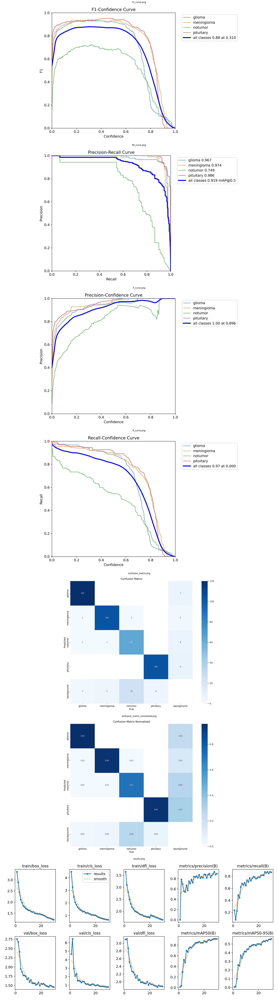

In [ ]:
image_paths = [
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adamax/detect/YOLOv8m_Adamax/F1_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adamax/detect/YOLOv8m_Adamax/PR_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adamax/detect/YOLOv8m_Adamax/P_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adamax/detect/YOLOv8m_Adamax/R_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adamax/detect/YOLOv8m_Adamax/confusion_matrix.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adamax/detect/YOLOv8m_Adamax/confusion_matrix_normalized.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adamax/detect/YOLOv8m_Adamax/results.png',
]
plot_images(image_paths)

### Testing

In [ ]:
def predict_results_on_YOLOv8m_Adam(test_images_dir):
    model = YOLO('/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adamax/detect/YOLOv8m_Adamax/weights/best.pt')

    image_files = [f for f in os.listdir(test_images_dir) if f.lower().endswith('.jpg')]

    for image_file in image_files:
        image_path = os.path.join(test_images_dir, image_file)
        model.predict(image_path, save=True, imgsz=512, conf=0.3)

In [ ]:
test_dir = '/content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images'
predict_results_on_YOLOv8m_Adam(test_dir)


image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images/Copy of Tr-gl_0045.jpg: 512x512 1 notumor, 25.7ms
Speed: 1.5ms preprocess, 25.7ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images/Copy of Tr-gl_0037.jpg: 512x512 1 notumor, 25.7ms
Speed: 1.4ms preprocess, 25.7ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images/Copy of Tr-gl_0029.jpg: 512x512 1 notumor, 26.6ms
Speed: 2.9ms preprocess, 26.6ms inference, 2.1ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images/Copy of Tr-gl_00

In [ ]:
def display_images(images, num_images_per_row=5):
    fig, axs = plt.subplots(len(images) // num_images_per_row, num_images_per_row, figsize=(30, 30))
    axs = axs.flatten()

    for i, img_path in enumerate(images):
        img = mpimg.imread(img_path)
        axs[i].imshow(img)
        axs[i].axis('off')

    plt.show()

In [ ]:
def get_random_images_from_dir(directory, num_images=5):
    all_images = [f for f in os.listdir(directory) if f.lower().endswith('.jpg')]
    random_images = random.sample(all_images, min(num_images, len(all_images)))
    return [os.path.join(directory, img) for img in random_images]

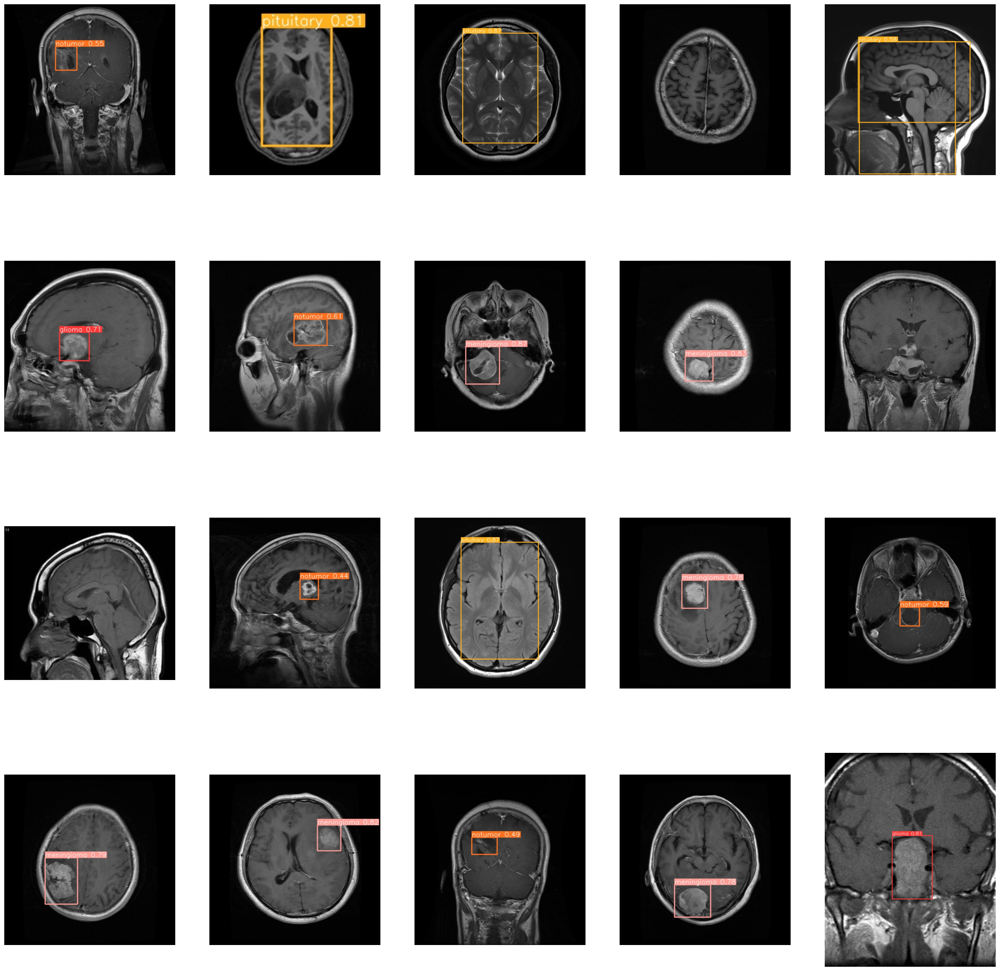

In [ ]:
random_images = get_random_images_from_dir('/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adamax_test_results/detect/predict', 20)
display_images(random_images)



---





---





---





---





---





---



# We have experimented on 5 different models [sizes and optimizers] we can try more also. Following are some experiments we can try.



---





---





---





---





---



## YOLOv8l Adamax

### Modelling

In [ ]:
yolov8l_btd_model = YOLO('yolov8l.yaml')
yolov8l_btd_model_results = yolov8l_btd_model.train(data = '/content/drive/MyDrive/brain_tumor_object_detection/brain_tumor_dataset.yaml',
                                                    epochs = 30,
                                                    batch = 32,
                                                    name = 'YOLOv8l_Adamax',
                                                    optimizer = 'Adamax',
                                                    lr0 = 0.001,
                                                    lrf = 0.001,
                                                    momentum = 0.85,
                                                    dropout = 0.5
                                                    )

Ultralytics YOLOv8.1.29 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8l.yaml, data=/content/drive/MyDrive/brain_tumor_object_detection/brain_tumor_dataset.yaml, epochs=30, time=None, patience=100, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=YOLOv8l_Adamax, exist_ok=False, pretrained=True, optimizer=Adamax, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.5, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=

100%|██████████| 755k/755k [00:00<00:00, 15.5MB/s]


Overriding model.yaml nc=80 with nc=4

                   from  n    params  module                                       arguments                     
  0                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  1                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  2                  -1  3    279808  ultralytics.nn.modules.block.C2f             [128, 128, 3, True]           
  3                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  4                  -1  6   2101248  ultralytics.nn.modules.block.C2f             [256, 256, 6, True]           
  5                  -1  1   1180672  ultralytics.nn.modules.conv.Conv             [256, 512, 3, 2]              
  6                  -1  6   8396800  ultralytics.nn.modules.block.C2f             [512, 512, 6, True]           
  7                  -1  1   2360320  ultralytics

100%|██████████| 6.23M/6.23M [00:00<00:00, 67.6MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/train/glioma.cache... 1740 images, 2 backgrounds, 0 corrupt: 100%|██████████| 1740/1740 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test/glioma.cache... 431 images, 4 backgrounds, 0 corrupt: 100%|██████████| 435/435 [00:00<?, ?it/s]


Plotting labels to runs/detect/YOLOv8l_Adamax/labels.jpg... 
optimizer: Adamax(lr=0.001, momentum=0.85) with parameter groups 97 weight(decay=0.0), 104 weight(decay=0.0005), 103 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/YOLOv8l_Adamax
Starting training for 30 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/55 [00:00<?, ?it/s]


OutOfMemoryError: CUDA out of memory. Tried to allocate 26.00 MiB. GPU 0 has a total capacity of 14.75 GiB of which 25.06 MiB is free. Process 6247 has 14.72 GiB memory in use. Of the allocated memory 14.45 GiB is allocated by PyTorch, and 86.65 MiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)

### Performance Metrics

In [ ]:
image_paths = [
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adamax/detect/YOLOv8m_Adamax/F1_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adamax/detect/YOLOv8m_Adamax/PR_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adamax/detect/YOLOv8m_Adamax/P_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adamax/detect/YOLOv8m_Adamax/R_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adamax/detect/YOLOv8m_Adamax/confusion_matrix.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adamax/detect/YOLOv8m_Adamax/confusion_matrix_normalized.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adamax/detect/YOLOv8m_Adamax/results.png',
]
plot_images(image_paths)

### Testing

In [ ]:
def predict_results_on_YOLOv8m_Adam(test_images_dir):
    model = YOLO('/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adamax/detect/YOLOv8m_Adamax/weights/best.pt')

    image_files = [f for f in os.listdir(test_images_dir) if f.lower().endswith('.jpg')]

    for image_file in image_files:
        image_path = os.path.join(test_images_dir, image_file)
        model.predict(image_path, save=True, imgsz=512, conf=0.3)

In [ ]:
test_dir = '/content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test_images'
predict_results_on_YOLOv8m_Adam(test_dir)

In [ ]:
def display_images(images, num_images_per_row=5):
    fig, axs = plt.subplots(len(images) // num_images_per_row, num_images_per_row, figsize=(30, 30))
    axs = axs.flatten()

    for i, img_path in enumerate(images):
        img = mpimg.imread(img_path)
        axs[i].imshow(img)
        axs[i].axis('off')

    plt.show()

In [ ]:
def get_random_images_from_dir(directory, num_images=5):
    all_images = [f for f in os.listdir(directory) if f.lower().endswith('.jpg')]
    random_images = random.sample(all_images, min(num_images, len(all_images)))
    return [os.path.join(directory, img) for img in random_images]

In [ ]:
random_images = get_random_images_from_dir('/content/drive/MyDrive/brain_tumor_object_detection/yolov8m_Adamax_test_results/detect/predict', 20)
display_images(random_images)

## YOLOv8l NAdam

## YOLOv8x

## YOLOv8x RAdam

## Rough

In [ ]:
directory_to_delete = '/content/runs'

# Use shutil.rmtree() to delete the directory and its contents
shutil.rmtree(directory_to_delete)

In [ ]:
import os

main_directory = '/content/drive/MyDrive/brain_tumor_object_detection/data/Brain Tumor labeled dataset/test'

def delete_txt_files(directory):
    for root, dirs, files in os.walk(directory):
        for file in files:
            if file.endswith('.txt'):
                file_path = os.path.join(root, file)
                os.remove(file_path)

delete_txt_files(main_directory)
print("All .txt files deleted.")


All .txt files deleted.


In [ ]:
!pip install numba

from numba import cuda
device = cuda.get_current_device()
device.reset()

In [ ]:
image_urls = [
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8n/detect/train3/PR_curve.png',
    '/content/drive/MyDrive/brain_tumor_object_detection/yolov8n/detect/train3/confusion_matrix.png',
]

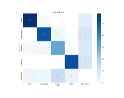

In [ ]:
plt.subplot(5, 2, 1)
for url in image_urls:
    img = mpimg.imread(url)
    plt.imshow(img)
    plt.axis('off')
    plt.tight_layout()
plt.show()